In [1]:
pip install plotly

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [2]:
# Importar librerías necesarias
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import payments_manager as pm
import plotly.express as px

#pm.help()
pm.init(debug=True)
pm.info()
df_jo = pm.df('df_jo')
df_jo.info()

Lista de dataframes: ['cr', 'fe', 'cr_cp', 'fe_cp', 'df_jo', 'df_jall']
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32094 entries, 0 to 32093
Data columns (total 31 columns):
 #   Column                      Non-Null Count  Dtype          
---  ------                      --------------  -----          
 0   id_cr                       32094 non-null  int64          
 1   amount                      32094 non-null  float64        
 2   stat_cr                     32094 non-null  object         
 3   created_at                  32094 non-null  datetime64[ns] 
 4   user_id                     32094 non-null  int64          
 5   active                      32094 non-null  int64          
 6   moderated_at                21759 non-null  datetime64[ns] 
 7   reimbursement_date          32094 non-null  datetime64[ns] 
 8   cash_request_received_date  24149 non-null  datetime64[ns] 
 9   money_back_date             23917 non-null  datetime64[ns] 
 10  transfer_type               32094 

In [3]:
cr_cp = pm.df('cr_cp')
fe_cp = pm.df('fe_cp')
cr_cp.info()
fe_cp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23970 entries, 0 to 23969
Data columns (total 23 columns):
 #   Column                      Non-Null Count  Dtype          
---  ------                      --------------  -----          
 0   id                          23970 non-null  int64          
 1   amount                      23970 non-null  float64        
 2   status                      23970 non-null  object         
 3   created_at                  23970 non-null  datetime64[ns] 
 4   updated_at                  23970 non-null  datetime64[ns] 
 5   user_id                     23970 non-null  int64          
 6   moderated_at                16035 non-null  datetime64[ns] 
 7   deleted_account_id          2104 non-null   float64        
 8   reimbursement_date          23970 non-null  datetime64[ns] 
 9   cash_request_received_date  16289 non-null  datetime64[ns] 
 10  money_back_date             16543 non-null  datetime64[ns] 
 11  transfer_type               23970 non-nul

In [4]:
df_jo.head()

,id_cr,amount,stat_cr,created_at,user_id,active,moderated_at,reimbursement_date,cash_request_received_date,money_back_date,...,type,stat_fe,category,fee,paid_at,from_date,to_date,charge_moment,cr_received_date,to_reimbur_cash_de
0,5,100.0,rejected,2019-12-10 19:05:21.596873,804,1,2019-12-11 16:47:42.405646,2020-01-09 19:05:21.596363,NaT,NaT,...,NaN,NaN,NaN,NaN,NaT,NaT,NaT,NaN,NaT,NaN
1,70,100.0,rejected,2019-12-10 19:50:12.347780,231,1,2019-12-11 14:24:22.897988,2020-01-09 19:50:12.347780,NaT,NaT,...,NaN,NaN,NaN,NaN,NaT,NaT,NaT,NaN,NaT,NaN
2,7,100.0,rejected,2019-12-10 19:13:35.825460,191,1,2019-12-11 09:46:59.777728,2020-01-09 19:13:35.825041,NaT,NaT,...,NaN,NaN,NaN,NaN,NaT,NaT,NaT,NaN,NaT,NaN
3,10,99.0,rejected,2019-12-10 19:16:10.880172,761,1,2019-12-18 14:26:18.128407,2020-01-09 19:16:10.879606,NaT,NaT,...,NaN,NaN,NaN,NaN,NaT,NaT,NaT,NaN,NaT,NaN
4,1594,100.0,rejected,2020-05-06 09:59:38.877376,7686,1,2020-05-07 09:21:55.320193,2020-06-05 22:00:00.000000,NaT,NaT,...,NaN,NaN,NaN,NaN,NaT,NaT,NaT,NaN,NaT,NaN


In [5]:
# Identificar columnas numericas CR
columnas_numericas_cash_request=cr_cp.describe().columns.tolist()
columnas_numericas_cash_request
# Identificar valores atipicos en esas columnas numericas mediante boxplots 
for c in columnas_numericas_cash_request:
    fig = px.box(cr_cp, y=c, title=f'Boxplot de {c}')
    fig.show()

In [6]:
# Identificar columnas numericas FEES
columnas_numericas_fees=fe_cp.describe().columns.tolist()
columnas_numericas_fees
# Identificar valores atipicos en esas columnas numericas mediante boxplots 
for c in columnas_numericas_fees:
    fig = px.box(fe_cp, y=c, title=f'Boxplot de {c}')
    fig.show()

In [7]:
# Para hacernos una idea de los datos que hay, de los valores nulos, y de los valores que toma cada columna, hacemos value_counts y unique, así como len(unique()) para todos los casos
for col in fe_cp.columns:
    print(f"'{col}' value_counts: {fe_cp[col].value_counts()}")
    print(f"'{col}' unique: {fe_cp[col].unique()}")
    print(f"'{col}' len(unique): {len(fe_cp[col].unique())}\n")

'id' value_counts: id
13301    1
6537     1
6961     1
16296    1
20775    1
        ..
15431    1
20539    1
14187    1
19956    1
17029    1
Name: count, Length: 21061, dtype: int64
'id' unique: [ 6537  6961 16296 ... 18779 16542 13301]
'id' len(unique): 21061

'cash_request_id' value_counts: cash_request_id
12225    35
5006     28
4410     24
12452    23
11376    21
         ..
21858     1
24479     1
24822     1
26203     1
26376     1
Name: count, Length: 12934, dtype: int64
'cash_request_id' unique: [14941 11714 23371 ... 20262 26764 25331]
'cash_request_id' len(unique): 12934

'type' value_counts: type
instant_payment    11099
postpone            7766
incident            2196
Name: count, dtype: int64
'type' unique: ['instant_payment' 'incident' 'postpone']
'type' len(unique): 3

'status' value_counts: status
accepted     14841
cancelled     4938
rejected      1194
confirmed       88
Name: count, dtype: int64
'status' unique: ['rejected' 'accepted' 'cancelled' 'confirmed']
'stat

In [8]:
# Lo mismo para CR hacemos value_counts y unique, así como len(unique()) para todos los casos
for col in cr_cp.columns:
    print(f"'{col}' value_counts: {cr_cp[col].value_counts()}")
    print(f"'{col}' unique: {cr_cp[col].unique()}")
    print(f"'{col}' len(unique): {len(cr_cp[col].unique())}\n")

'id' value_counts: id
19886    1
5        1
19774    1
26021    1
22957    1
        ..
3512     1
2145     1
1594     1
10       1
7        1
Name: count, Length: 23970, dtype: int64
'id' unique: [    5    70     7 ... 22357 20256 19886]
'id' len(unique): 23970

'amount' value_counts: amount
100.0    16094
50.0      5304
25.0      1276
80.0       267
60.0       190
70.0       151
20.0       132
30.0       114
40.0       100
90.0        91
10.0        57
200.0       25
95.0        21
1.0         19
75.0        18
45.0        15
55.0        14
99.0        12
65.0        12
15.0        10
85.0         9
35.0         9
5.0          6
2.0          3
98.0         2
28.0         2
22.0         2
11.0         2
94.0         1
150.0        1
67.0         1
72.0         1
31.0         1
8.0          1
86.0         1
97.0         1
39.0         1
49.0         1
36.0         1
54.0         1
24.0         1
Name: count, dtype: int64
'amount' unique: [100.  99.  90.   1.  70.  25.  50.  20.  60.  8

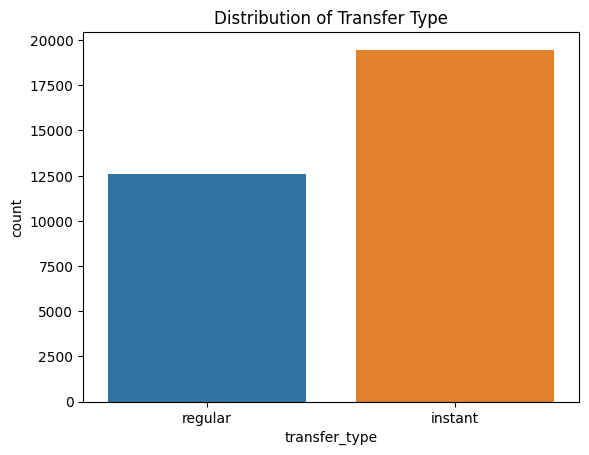

In [9]:
#Comparar las de cash_request segun el tipo de transferencia
#sacamos los registros donde el status=canceled (pues en teoria son los que no siguieron adelante porque el usuario no confirmó)
df_jo_nocanceled = df_jo[df_jo['stat_cr'] != 'canceled']

sns.countplot(data=df_jo_nocanceled, x='transfer_type', hue='transfer_type', palette='tab10')
plt.title("Distribution of Transfer Type")
plt.show()

In [10]:
df_jo_sicanceled = df_jo[df_jo['stat_cr'] == 'canceled']
df_jo_sicanceled.info()

<class 'pandas.core.frame.DataFrame'>
Index: 35 entries, 8 to 10939
Data columns (total 31 columns):
 #   Column                      Non-Null Count  Dtype          
---  ------                      --------------  -----          
 0   id_cr                       35 non-null     int64          
 1   amount                      35 non-null     float64        
 2   stat_cr                     35 non-null     object         
 3   created_at                  35 non-null     datetime64[ns] 
 4   user_id                     35 non-null     int64          
 5   active                      35 non-null     int64          
 6   moderated_at                3 non-null      datetime64[ns] 
 7   reimbursement_date          35 non-null     datetime64[ns] 
 8   cash_request_received_date  1 non-null      datetime64[ns] 
 9   money_back_date             2 non-null      datetime64[ns] 
 10  transfer_type               35 non-null     object         
 11  send_at                     20 non-null     datet

# cosas raras?
Tenemos cash_requests que tienen status canceled (no hizo confirmación y automaticamente cancelaron) y aun asi tienen reimbursement, send_At, paid_at...

También tenemos un monton de registros con el send_at vacío (no tenemos registro de haber mandado el dinero) y aun así tienen status de money_back, active...etc. Por lo que puede no haberse registrado el send_at correctamente.

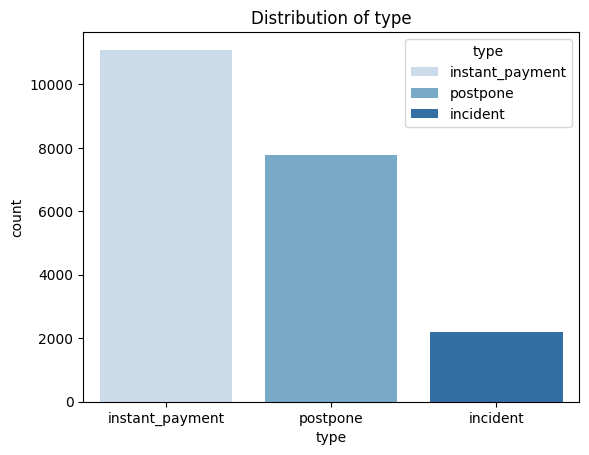

In [11]:
sns.countplot(data=df_jo_nocanceled, x='type', hue='type', palette='Blues')
plt.title("Distribution of type")
plt.show()

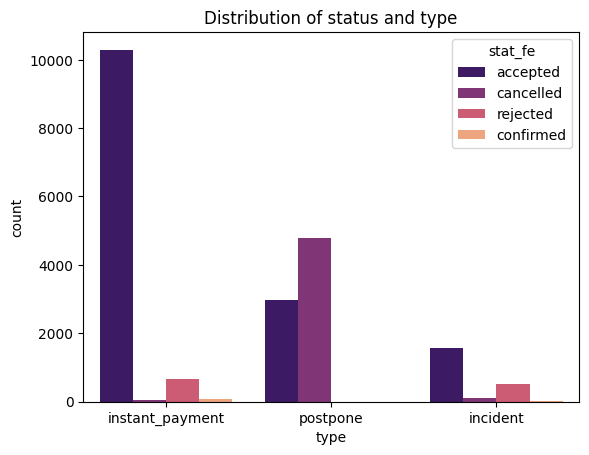

In [12]:
sns.countplot(data=df_jo_nocanceled, x='type', hue='stat_fe', palette='magma')
plt.title("Distribution of status and type")
plt.show()

In [13]:
#Veamos en el tiempo como han evolucionado las cash_requests
fig = px.histogram(cr_cp, x='created_at', nbins=500, title='Frequency of cash requests')
fig.show()

In [14]:
fig2 = px.histogram(cr_cp, x='reimbursement_date', nbins=500, title='Frequency of reimbursement date')
fig2.show()

In [15]:
fig3 = px.histogram(cr_cp, x='updated_at', nbins=500, title='Frequency of updated at cr')
fig3.show()

In [16]:
# Calculamos la diferencia entre fecha creacion cr y la fecha planeada de reembolso
# Convertimos a datetime

df_jo['created_at'] = pd.to_datetime(df_jo['created_at'], format = 'mixed')
df_jo['reimbursement_date'] = pd.to_datetime(df_jo['reimbursement_date'], format = 'mixed')

# En una columna nueva ponemos la diferencia en dias 
df_jo['time_diff_created_reimburs_days'] = (df_jo['reimbursement_date'] - df_jo['created_at']).dt.days


# Calculamos la mediana
mediana=df_jo['time_diff_created_reimburs_days'].median()
media=df_jo['time_diff_created_reimburs_days'].mean()

print(mediana)
print(media)


24.0
29.109335078207764


In [17]:
# Comprobamos que no hay ninguna diferencia negativa que sería inconsistente

negative_rows = df_jo.loc[df_jo['time_diff_created_reimburs_days'] < 0]
negative_rows

,id_cr,amount,stat_cr,created_at,user_id,active,moderated_at,reimbursement_date,cash_request_received_date,money_back_date,...,stat_fe,category,fee,paid_at,from_date,to_date,charge_moment,cr_received_date,to_reimbur_cash_de,time_diff_created_reimburs_days
17197,8626,60.0,money_back,2020-07-17 10:37:54.852063,33881,1,2020-07-17 15:47:55,2020-04-03 22:00:00,2020-07-21,2020-07-29 00:53:41.172353,...,accepted,NaN,5.0,2020-07-24 13:07:33.580417,2020-08-01 22:00:00,2020-08-03 22:00:00,before,2020-07-21,NaN,-105


In [18]:
fig4 = px.histogram(df_jo, x='time_diff_created_reimburs_days', nbins=100, title='Frequency of days until reimbursement')
fig4.update_xaxes(nticks=50) 
fig4.show()

In [19]:
# money_back_date

fig5 = px.histogram(cr_cp, x='money_back_date', nbins=500, title='Frequency of money back dates')
fig5.show()

In [20]:
# veamos la columna created_at para el fees

fig6 = px.histogram(fe_cp, x='created_at', nbins = 1000, title='Frequency of created_at para Fees')

fig6.show()

In [21]:
# Veamos el updated_at para fees

fig7 = px.histogram(fe_cp, x='updated_at', nbins = 150, title='Frequency of updated_at para Fees')

fig7.show()

In [22]:
# veamos de las fees que no han sido pagadas como se distribuyen segun el charge_moment y el type 
df_filtered = df_jo[df_jo['paid_at'].isna()]

counts = df_filtered.groupby(['charge_moment', 'type']).size().reset_index(name='count')

figure8 = px.bar(counts, 
             x='charge_moment', 
             y='count', 
             color='type', 
             barmode='group', 
             text='count',
             title='Count of Charge Moment vs Type')

figure8.show()

In [23]:
# idem del fees no pagadas pero para charge_moment y status
counts_status = df_filtered.groupby(['charge_moment', 'stat_fe']).size().reset_index(name='count')

figure9 = px.bar(counts_status, 
             x='charge_moment', 
             y='count', 
             color='stat_fe', 
             barmode='group', 
             text='count',
             title='Count of Charge Moment vs status')

figure9.show()

In [24]:
# por status and type

counts_type = df_filtered.groupby(['stat_fe', 'type']).size().reset_index(name='count')

figure10 = px.bar(counts_type, 
             x='stat_fe', 
             y='count', 
             color='type', 
             barmode='group', 
             text='count',
             title='Count of Status vs Type')

figure10.show()

In [27]:
# por status and type en cash_request ahora

counts_type_cr = df_filtered.groupby(['stat_cr', 'transfer_type']).size().reset_index(name='count')
counts_type_cr

,stat_cr,transfer_type,count
0,active,instant,62
1,active,regular,61
2,canceled,instant,11
3,canceled,regular,22
4,direct_debit_rejected,instant,409
5,direct_debit_rejected,regular,420
6,direct_debit_sent,instant,29
7,direct_debit_sent,regular,8
8,money_back,instant,2717
9,money_back,regular,6210


In [30]:


figure11 = px.bar(counts_type_cr, 
             x='stat_cr', 
             y='count', 
             color='transfer_type', 
             barmode='group', 
             text='count',
             title='Count of Status cr vs Type')

figure11.show()

In [ ]:
# graficar la suma acumulativa del valor (total_amount) a lo largo del tiempo:
df_jo2=df_jo.copy()

df_jo2 = df_jo2.sort_values('created_at') #ordenamos segun created_at

df_jo2['total_amount_cumsum'] = df_jo2['total_amount'].cumsum() #calculamos la suma acumulativa

fig_cumsum = px.line(df_jo2, 
                     x='created_at', 
                     y='total_amount_cumsum',   
                     title='suma acumulativa (monthly grouping)'
                    )
fig_cumsum.show()